# Chapter 4 - Pathways 4.4 Attack

In [1]:
import matplotlib.pyplot as plt
import networkx as nx
import pandas as pd
import glob
import numpy as np
import pickle 
import statistics as st
import seaborn as sb
import random as rd

In [2]:
class SuperPathwayClass:
    def __init__(self, name,idPathway,geneSet,networkWithCCs,networkLCC,drivers):
        self.name = name
        self.idPathway = idPathway
        self.geneSet = geneSet
        self.networkCCs = networkWithCCs
        self.networkLCC = networkLCC
        self.drivers = drivers
        self.topologicalFeaturesLCC = None
        self.layout_LCC_kamada_kawai= None
        self.layout_CCs_spring = None
        
    def info(self):
        info={}
        info['Name'] = self.name
        info['idPathway'] = self.idPathway        
        info['lenSet'] = len(self.geneSet)
        info['lenCCs'] = str(len(self.networkCCs.nodes)) +' ('+str(round(len(self.networkCCs.nodes)/len(self.geneSet)*100))+'%)'
        info['lenLCC'] = str(len(self.networkLCC.nodes)) +' ('+str(round(len(self.networkLCC.nodes)/len(self.geneSet)*100))+'%)'       
        driversLen = len(self.drivers)
        info['driversLCC'] = driversLen
        info['drivers %'] = round(driversLen/len(self.networkLCC.nodes)*100)
        
        return info

In [3]:
file = open("inputs/superPathwaysObjs.pkl", "rb")
superPathwaysObjs = pickle.load(file)
overView={}
for k in sorted(superPathwaysObjs):
    overView[k]=superPathwaysObjs[k].info()
    
overViewDf=pd.DataFrame.from_dict(overView,orient='index')
overViewDf.set_index(overViewDf.columns[0],inplace=True)
overViewDf.sort_values(by=['drivers %'],ascending=False).head()

,idPathway,lenSet,lenCCs,lenLCC,driversLCC,drivers %
Name,,,,,,
Chromatin organization,R-HSA-4839726,240,218 (91%),206 (86%),45,22
Circadian Clock,R-HSA-400253,70,69 (99%),64 (91%),12,19
DNA Repair,R-HSA-73894,312,290 (93%),284 (91%),48,17
Reproduction,R-HSA-1474165,114,95 (83%),81 (71%),14,17
Disease,R-HSA-1643685,1888,1513 (80%),1415 (75%),206,15


In [4]:
targetPathways=['Chromatin Organization','Circadian Clock','DNA Repair','Reproduction']
superPathwaysObjs['Chromatin Organization']=superPathwaysObjs['Chromatin organization']
superPathwaysObjs['Chromatin Organization'].name='Chromatin Organization'

# Rename the column names

In [5]:
for name in superPathwaysObjs:
    superPathwaysObjs[name].topologicalFeaturesLCC.rename(
        columns={
            'degree':'Degree',
            'kcore':'Kcore',
            'eigenvector':'Eigenvector',
            'averageNeighbor': 'AvgNeighbors', 
            'clusteringcoeff': 'Clustering',
            'leverage': 'Leverage',
            'eccentricity': 'Eccentricity',
            'betweenness': 'Betweenness',
            'closeness': 'Closeness',
            'bridging': 'Bridging',
        },inplace=True)
    superPathwaysObjs[name].topologicalFeaturesLCC

# Attack Function

In [6]:
repeat=100

In [7]:
def getErroSTD(mr):
    #Calculate the variance.
    results=[r[1] for r in mr]
    resultsVariance=[]
    #results is a matriz. Each line is a repetion that contains 'howMany' values
    #The columns in this matriz are the values found in a point in time (f). So we the variance for each point 
    numberOfColumns = len(results[0])
    for col in range(numberOfColumns):
        colValues=[]
        for line in results:
            colValues.append(line[col])
        resultsVariance.append(np.std(colValues))   
    return resultsVariance

def plotRandomAttack(G_original,howMany):
    matrizOfResults=[]
    for _ in range(repeat):
        G = G_original.copy()
        Nstart = G.number_of_nodes()
        yAxis=[1]
        xAxis=[0]
        listOfNode = list(G.nodes)
        rd.shuffle(listOfNode)#Randomize the nodes
        for i,_ in enumerate(range(howMany)):
            G.remove_node(listOfNode[i])
            Nactual = G.number_of_nodes()
            CCs = nx.connected_components(G)
            if Nactual != 0:
                LCC = max(CCs,key=len)
                #𝑃∞(𝑓)/𝑃∞(0)  = len(LCC)/Nstart # Because we start with a connect network, with only one connect component
                impact = len(LCC)/Nstart
            else:
                impact = 0 
            f = 1 - Nactual/Nstart
            yAxis.append(impact)
            xAxis.append(f)
            
        matrizOfResults.append([np.array(xAxis),np.array(yAxis)])
        
    y = np.array(matrizOfResults[0][1])
    for ex in matrizOfResults:
        y+=ex[1]
    y=y/(repeat+1)    
    
    error=getErroSTD(matrizOfResults)
    plt.errorbar(xAxis,y,label='Random', yerr=error, ecolor='lightgreen', elinewidth=2, capsize=0,fmt='-',color='limegreen',linewidth=2)
    return matrizOfResults

def plotHubAttack(G_original,howMany):
    matrizOfResults=[]
    for _ in range(repeat):
        G = G_original.copy()
        Nstart = G.number_of_nodes()
        yAxis=[1]
        xAxis=[0]

        #verticesOrdenados is a list of tuples (verticeName,degree)
        verticesOrdenados = list(dict(sorted(dict(G.degree).items(), key=lambda x:x[1],reverse=True)).items())
        #In case two or more hubs have the same degree
        first=verticesOrdenados[0]
        equalsToFirst=[first[0]]
        cont=1
        while cont<len(verticesOrdenados) and first[1] == verticesOrdenados[cont][1]:
            equalsToFirst.append(verticesOrdenados[cont][0])
            cont+=1
        #randomize the list of hubs that have the same degree
        rd.shuffle(equalsToFirst)
        verticeToRemove=equalsToFirst[0]

        for step in range(howMany):    
            G.remove_node(verticeToRemove)
            Nactual = G.number_of_nodes()
            CCs = nx.connected_components(G)
            if Nactual != 0:
                LCC = max(CCs,key=len)
                #𝑃∞(𝑓)/𝑃∞(0)  = len(LCC)/Nstart # Because we start with a connect network, with only one connect component
                impact = len(LCC)/Nstart
            else:
                impact = 0 
            f = 1 - Nactual/Nstart
            yAxis.append(impact)
            xAxis.append(f)

            #verticesOrdenados is a list of tuples (verticeName,degree)
            verticesOrdenados = list(dict(sorted(dict(G.degree).items(), key=lambda x:x[1],reverse=True)).items())
            #In case two or more hubs have the same degree
            if(len(verticesOrdenados)>0):
                first=verticesOrdenados[0]
                equalsToFirst=[first[0]]
                cont=1
                while cont<len(verticesOrdenados) and first[1] == verticesOrdenados[cont][1]:
                    equalsToFirst.append(verticesOrdenados[cont][0])
                    cont+=1
                #randomize the list of hubs that have the same degree
                rd.shuffle(equalsToFirst)
                verticeToRemove=equalsToFirst[0]


        matrizOfResults.append([np.array(xAxis),np.array(yAxis)])

    #Calculate the average of all repeat
    y = np.array(matrizOfResults[0][1])
    for ex in matrizOfResults:
        y+=ex[1]
    y=y/(repeat+1)
    
    #Calculate de error and plotIT
    error=getErroSTD(matrizOfResults)

    plt.errorbar(xAxis,y,label='Hubs', yerr=error, ecolor='skyblue', elinewidth=2, capsize=0,fmt='-',color='blue',linewidth=2)

# Attack

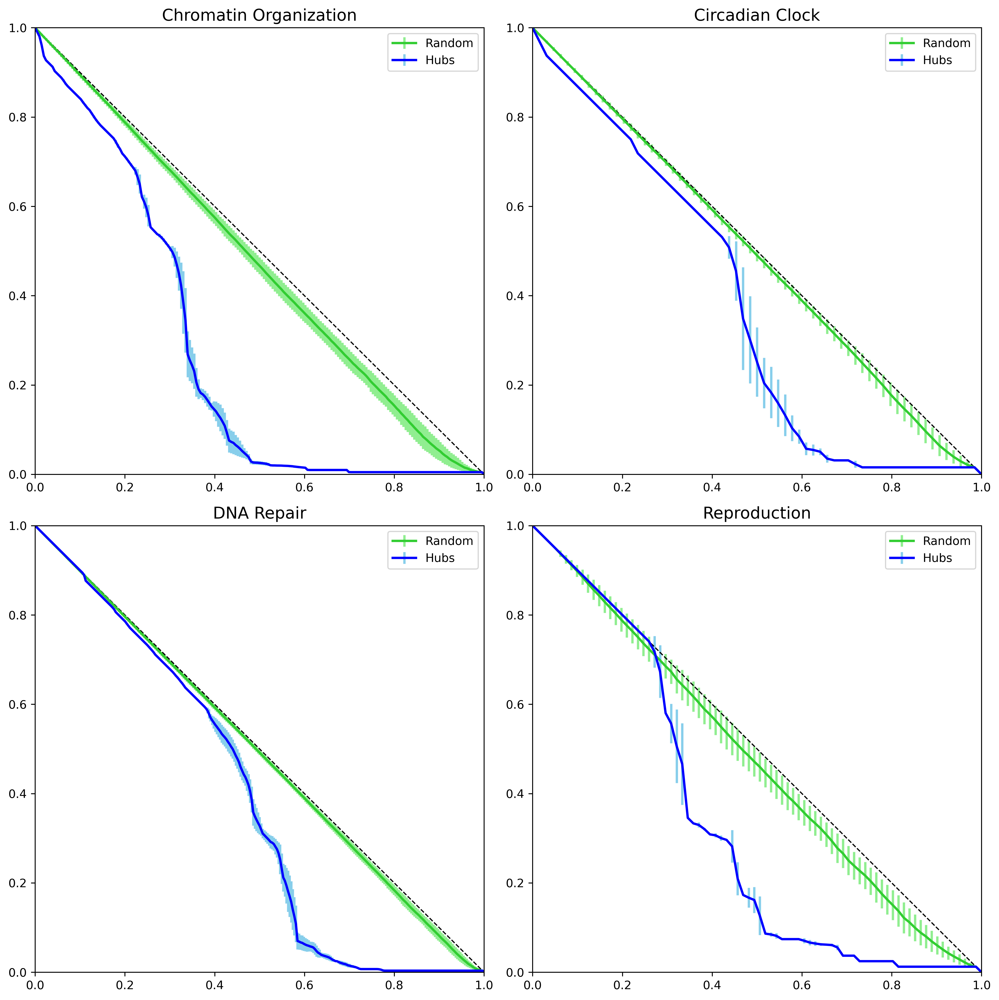

Wall time: 58 s


In [8]:
%%time
#Plotting    
plt.figure(figsize=(12,12),dpi=450)
for i,name in enumerate(targetPathways):
    obj=superPathwaysObjs[name]
    pathN=obj.networkLCC
    pathN.name = name

    # fmax (how many node will be removed)
    fmax = len(pathN)

    N= pathN.number_of_nodes()
    fPerccent=fmax/N


    plt.subplot(2,2,i+1)
    plotRandomAttack(pathN,fmax)
    plotHubAttack(pathN,fmax)    
    

    plt.plot([0, fPerccent], [1,1-fPerccent], 'k--',linewidth=1)
    plt.margins(x=0)
    plt.margins(y=0)
    plt.title(pathN.name,fontsize=14)
    plt.legend()
    plt.tight_layout()

plt.savefig("ouput/4.4 Attack.png", format='png', dpi=550)
plt.savefig("ouput/4.4 Attack.svg", format='svg')
plt.savefig("ouput/4.4 Attack.pdf", format='pdf')
plt.show()  
plt.close()

In [7]:
for name in targetPathways:
    obj=superPathwaysObjs[name]
    pathN=obj.networkLCC
    pathN.name = name
    print(nx.info(pathN))
    print('Clustering',round(nx.average_clustering(pathN),2))
    print('\n')

Name: Chromatin Organization
Type: Graph
Number of nodes: 206
Number of edges: 1875
Average degree:  18.2039
Clustering 0.63


Name: Circadian Clock
Type: Graph
Number of nodes: 64
Number of edges: 623
Average degree:  19.4688
Clustering 0.69


Name: DNA Repair
Type: Graph
Number of nodes: 284
Number of edges: 6701
Average degree:  47.1901
Clustering 0.71


Name: Reproduction
Type: Graph
Number of nodes: 81
Number of edges: 849
Average degree:  20.9630
Clustering 0.77




# Attack on Synthetic Network

In [8]:
# As redes tem qtde de vertices e arestas diferentes, mas na média é isso
#avgDegree == (18+20+47+21)/4 == 26,5
#avgNode   == (206+61+284+81)/4 == 158

scaleFree = nx.barabasi_albert_graph(158,15)
scaleFree.name='Barabasi Albert'
print(nx.info(scaleFree))
print('Clustering',round(nx.average_clustering(scaleFree),2))

Name: Barabasi Albert
Type: Graph
Number of nodes: 158
Number of edges: 2145
Average degree:  27.1519
Clustering 0.27


In [19]:
random = nx.watts_strogatz_graph(158,27,0.01)
random.name='Watts-Strogatz'
print(nx.info(random))
print('Clustering',round(nx.average_clustering(random),2))

Name: Watts-Strogatz
Type: Graph
Number of nodes: 158
Number of edges: 2054
Average degree:  26.0000
Clustering 0.71


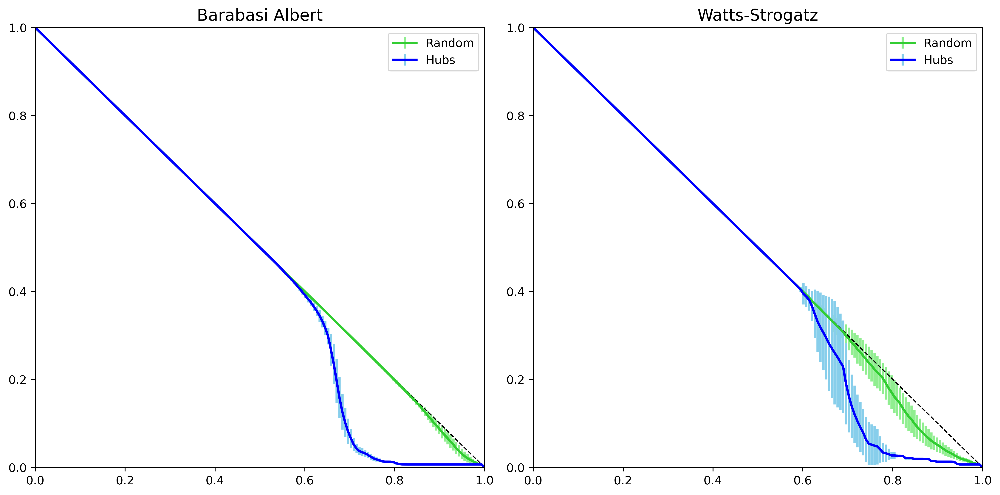

In [47]:
plt.figure(figsize=(12,6),dpi=450)
for i,G in enumerate([scaleFree,random]):
    pathN=G

    # fmax (how many node will be removed)
    fmax = len(pathN)

    N= pathN.number_of_nodes()
    fPerccent=fmax/N


    plt.subplot(1,2,i+1)
    plotRandomAttack(pathN,fmax)
    plotHubAttack(pathN,fmax)    
    

    plt.plot([0, fPerccent], [1,1-fPerccent], 'k--',linewidth=1)
    plt.margins(x=0)
    plt.margins(y=0)
    plt.title(pathN.name,fontsize=14)
    plt.legend()
    plt.tight_layout()

plt.savefig("ouput/4.4 Attack_Synthetic.png", format='png', dpi=550)
plt.savefig("ouput/4.4 Attack_Synthetic.svg", format='svg')
plt.savefig("ouput/4.4 Attack_Synthetic.pdf", format='pdf')
plt.show()  
plt.close()

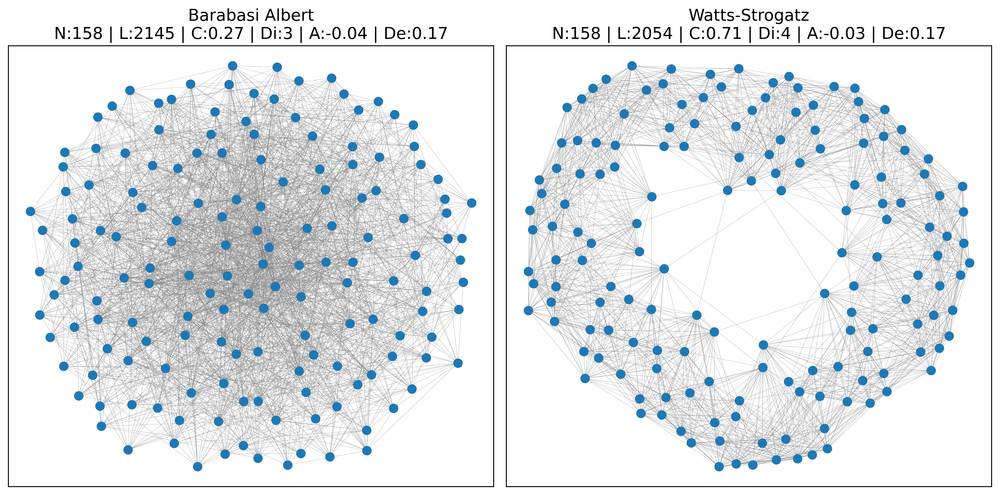

In [20]:
plt.figure(figsize=(12,6),dpi=550)
for i,G in enumerate([scaleFree,random]):
    
    pos=nx.kamada_kawai_layout(G)
    allNodes = list(G.nodes()) 
    A='A:'+str(round(nx.assortativity.degree_assortativity_coefficient(G),2))
    Di='Di:'+str(round(nx.diameter(G),2))
    De='De:'+str(round(nx.density(G),2))
    C='C:'+str(round(nx.average_clustering(G),2))
    N='N:'+str(G.number_of_nodes())
    L='L:'+str(G.number_of_edges())
    name=G.name+'\n'+N+' | '+L+' | '+C+' | '+Di+' | '+A+' | '+De
   
    plt.subplot(1,2,i+1)
    nx.draw_networkx_nodes(G, pos=pos, node_size=50, nodelist=allNodes, node_color='#1f78b4',node_shape='o')
    nx.draw_networkx_edges(G, pos=pos, alpha=1, edge_color='gray',width=0.15)
    plt.title(name,fontsize=14)
    plt.tight_layout()


# plt.savefig("ouput/4.4 Networks.png", format='png', dpi=550)
# plt.savefig("ouput/4.4 Networks.svg", format='svg')
# plt.savefig("ouput/4.4 Networks.pdf", format='pdf')
plt.show()
plt.close()

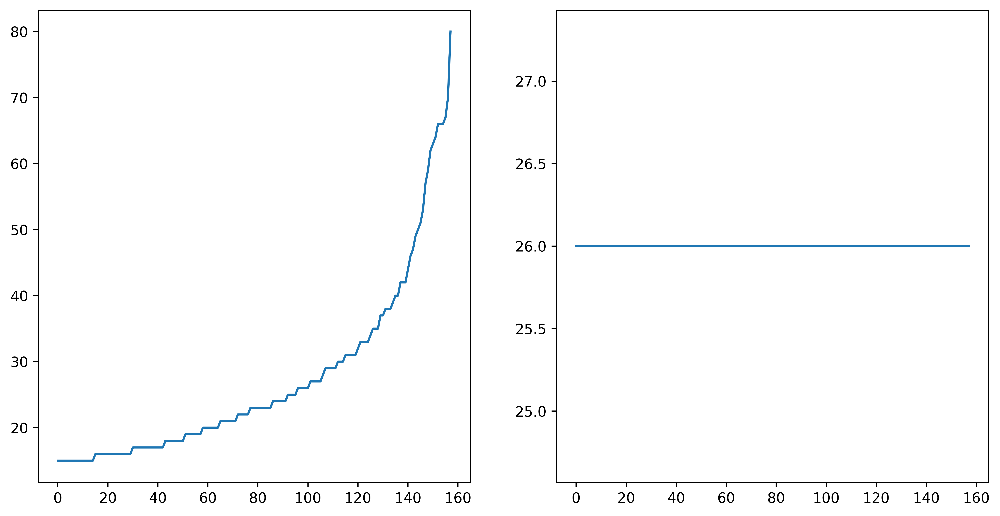

In [53]:
plt.figure(figsize=(12,6),dpi=550)
for i,G in enumerate([scaleFree,random]):
    

   
    plt.subplot(1,2,i+1)
    plt.plot(sorted(dict(nx.degree(G)).values()))


# plt.savefig("ouput/4.4 Networks.png", format='png', dpi=550)
# plt.savefig("ouput/4.4 Networks.svg", format='svg')
# plt.savefig("ouput/4.4 Networks.pdf", format='pdf')
plt.show()
plt.close()

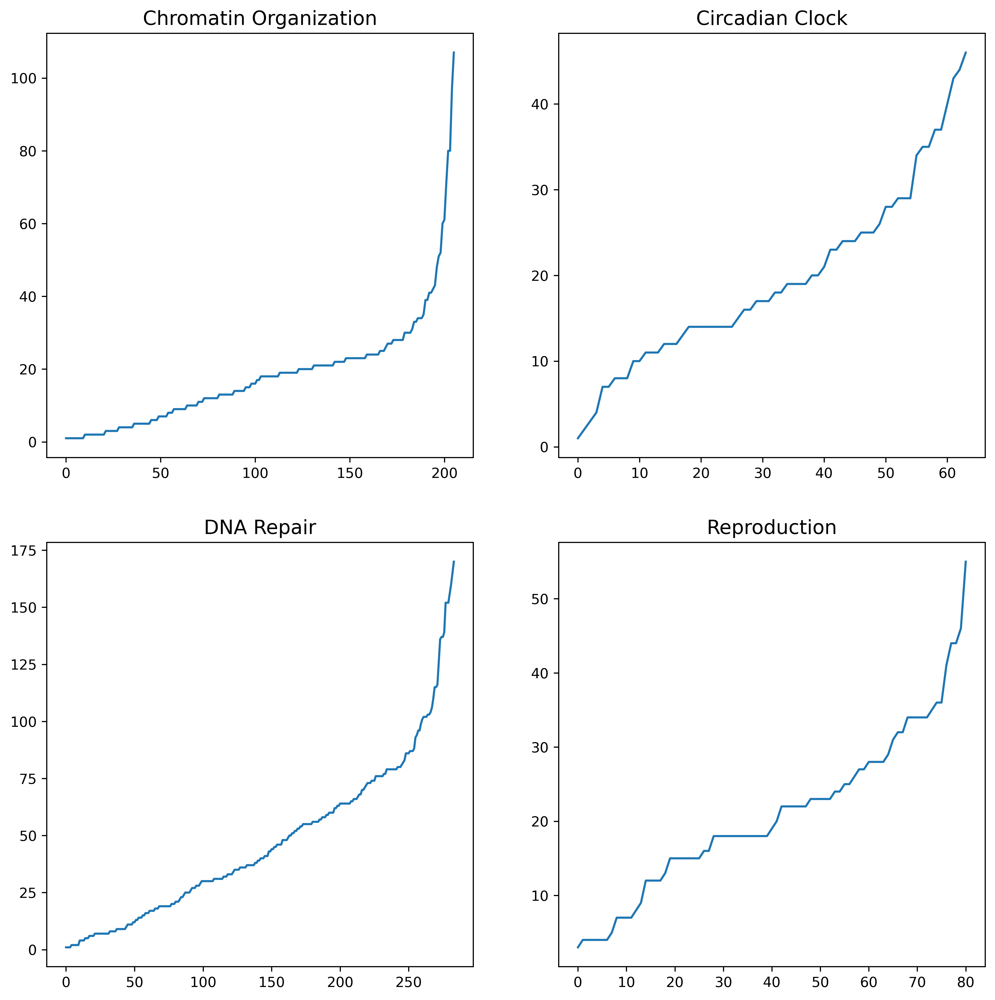

In [54]:
plt.figure(figsize=(12,12),dpi=450)
for i,name in enumerate(targetPathways):
    obj=superPathwaysObjs[name]
    pathN=obj.networkLCC
    pathN.name = name

    plt.subplot(2,2,i+1)

    plt.title(pathN.name,fontsize=14)
    plt.plot(sorted(dict(nx.degree(pathN)).values()))

plt.show()  
plt.close()
